# Electricity Usage Analysis

## Problem Description

    
In this challenge, you are asked to explore a dataset describing a household's environmental conditions and electricity usage. The dataset is a time series with variables representing the internal temperature and humidity monitored by sensors, the electricity usage sourced from the energy meter, and external weather conditions provided by a local weather station. All variables have been summarised into 10-minute intervals over a four-month period (2016 January to 2016 May). We are interested in predicting the electricity usage of the household (the variable named 'Appliances' in the dataset) given the internal and external environmental conditions. 


There are three tasks (in detailed task description can be in the later sections) you need to complete:  <br>
1. Modelling 
2. Model Performance 
3. Prediction


## Data Description

Column | Description
:---|:---
`date` |Timestamp
`Appliances` |Energy use in Wh
`lights` |Energy use of light fixtures in the house in Wh 
`T1`	|Temperature in kitchen area, in Celsius
`RH_1`	|Humidity in kitchen area, in % 
`T2`	|Temperature in living room area, in Celsius 
`RH_2`	|Humidity in living room area, in % 
`T3`	|Temperature in laundry room area 
`RH_3`	|Humidity in laundry room area, in % 
`T4`	|Temperature in office room, in Celsius 
`RH_4`	|Humidity in office room, in % 
`T5`	|Temperature in bathroom, in Celsius 
`RH_5`	|Humidity in bathroom, in % 
`T6`	|Temperature outside the building (north side), in Celsius 
`RH_6`	|Humidity outside the building (north side), in %
`T7`	|Temperature in ironing room , in Celsius 
`RH_7` 	|Humidity in ironing room, in % 
`T8` 	|Temperature in teenager room 2, in Celsius 
`RH_8` 	|Humidity in teenager room 2, in % 
`T9` 	|Temperature in parents room, in Celsius 
`RH_9` 	|Humidity in parents room, in % 
`T_out` 	|Temperature outside (from weather station), in Celsius
`Press_mm_hg`   |Pressure (from weather station), in mm Hg
`RH_out`    |Humidity outside (from weather station), in %
`Windspeed` |from weather station, in m/s 
`Visibility`    |from weather station, in km 
`Tdewpoint` |from weather station Â°C
`v1`	|unknown
`v2`	|unknown


    If you'd like to install packages that aren't installed by default. For example in Python, uncomment the last two lines of this cell and replace <package list> with a list of your packages. This will ensure your notebook has all the dependencies and works everywhere

In [2]:
for name in dir():
    if not name.startswith("_"):
        del globals()[name]

In [3]:
import sys
!{sys.executable} -m pip install hvplot

In [4]:
# Libraries
import pandas as pd
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt
import hvplot.pandas

from scipy.stats import boxcox
from scipy.special import inv_boxcox

from sklearn.preprocessing import MinMaxScaler, StandardScaler

pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [5]:
df_raw = pd.read_csv('dataset_1.csv', header='infer')
df_raw.set_index('date', inplace=True)

In [6]:
print(df_raw.shape)
df_raw.head()

(17610, 28)


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1,v2
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,NaN,48.863333,NaN,45.56,6.483333,733.6,92.0,6.666667,NaN,5.2,18.606195,18.606195
2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,NaN,92.0,6.333333,55.333333,5.1,28.642668,28.642668
2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,NaN,6.000000,51.500000,5.0,45.410390,45.410390
2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,NaN,18.1,48.590000,17.000000,45.40,6.133333,733.9,NaN,5.666667,47.666667,4.9,10.084097,10.084097


In [7]:
df_raw['Appliances'].value_counts()

50.0      3673
60.0      2669
40.0      1829
70.0      1303
80.0       972
90.0       835
100.0      797
30.0       645
110.0      569
120.0      418
20.0       328
130.0      258
140.0      179
150.0      114
260.0       72
190.0       70
160.0       67
230.0       66
270.0       65
280.0       64
240.0       64
180.0       63
300.0       60
250.0       60
310.0       59
390.0       58
220.0       58
170.0       56
210.0       55
370.0       53
360.0       53
330.0       53
290.0       52
340.0       50
320.0       50
350.0       49
200.0       47
400.0       41
380.0       38
410.0       35
440.0       29
420.0       25
430.0       23
450.0       19
480.0       19
470.0       18
510.0       17
530.0       15
610.0       15
460.0       14
590.0       12
500.0       12
490.0       11
630.0       10
600.0       10
520.0       10
660.0        9
540.0        9
700.0        9
580.0        9
10.0         9
560.0        9
620.0        9
750.0        7
690.0        7
550.0        6
650.0     

In [132]:
#plot_exclude_cols = ['Appliances', 'Press_mm_hg', 'v2', 'date']
#plot_cols = [col for col in df.columns if col not in plot_exclude_cols]

In [8]:
def get_df_plot(col_suffix, df):
    T_col = 'T' + col_suffix
    RH_col = 'RH_' + col_suffix
    return get_sub_df([T_col, RH_col], df)
    
def get_sub_df(plot_cols, df):
    df_plot = df[plot_cols]
    return (df_plot)

In [8]:
get_df_plot(str(1), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [9]:
get_df_plot(str(2), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [12]:
get_df_plot(str(3), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [13]:
get_df_plot(str(4), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [14]:
get_df_plot(str(5), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [15]:
get_df_plot(str(6), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [16]:
get_df_plot(str(7), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [17]:
get_df_plot(str(8), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [18]:
get_df_plot(str(9), df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [19]:
get_sub_df(['T_out', 'RH_out'], df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [20]:
get_sub_df(['Windspeed', 'Visibility', 'Tdewpoint'], df_raw).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [9]:
df_missing = pd.concat([df_raw.nunique(), df_raw.isnull().any(), df_raw.isnull().mean()], axis=1)
df_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']

In [10]:
df2 = df_raw[~df_raw['Appliances'].isna()]
df2_missing = pd.concat([df2.nunique(), df2.isnull().any(), df2.isnull().mean()], axis=1)
df2_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']

In [11]:
pd.merge(df_missing, df2_missing, how='left', left_index=True, right_index=True)

,nunique_x,isnull_any_x,isnull_proportion_x,nunique_y,isnull_any_y,isnull_proportion_y
Appliances,91,True,0.065361,91,False,0.000000
lights,8,True,0.070982,8,True,0.006015
T1,455,True,0.187166,455,True,0.130324
RH_1,1990,True,0.187507,1990,True,0.130688
T2,1000,True,0.194776,1000,True,0.138465
RH_2,2193,True,0.175355,2193,True,0.117686
T3,906,True,0.189495,906,True,0.132815
RH_3,1937,True,0.178365,1937,True,0.120906
T4,1058,True,0.147246,1058,True,0.087612
RH_4,2353,True,0.182964,2353,True,0.125828


In [12]:
df2.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1,v2
count,16459.000000,16360.000000,14314.000000,14308.000000,14180.000000,14522.000000,14273.000000,14469.000000,15017.000000,14388.000000,14713.000000,14736.000000,14081.000000,14778.000000,14176.000000,13656.000000,13836.000000,14851.000000,14622.000000,14423.000000,15255.000000,14123.000000,14921.000000,14347.000000,14136.000000,14571.000000,16459.000000,16459.000000
mean,96.233064,3.979218,21.414752,40.251411,20.080649,40.420256,21.942145,39.464091,20.475937,39.181212,19.290203,51.381855,7.252790,59.318436,19.817745,35.566067,21.673969,43.192832,19.047572,41.646827,6.883926,754.760230,80.347173,4.162362,38.390416,3.353586,24.934725,24.934725
std,102.028297,8.078989,1.490041,3.762065,2.017415,3.878033,1.791557,3.231000,1.892605,4.241162,1.637380,9.166196,5.721476,30.568345,1.895629,4.886559,1.872606,5.108030,1.776328,4.113704,5.089788,7.488678,14.770104,2.522996,11.416429,3.911612,14.517159,14.517159
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.596667,17.200000,30.663333,15.100000,27.660000,15.330000,29.815000,-6.030000,1.000000,15.390000,23.200000,16.362222,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.600000,37.560000,18.730000,38.000000,20.600000,37.090000,19.290000,35.879000,18.100000,45.709688,3.333333,36.790000,18.500000,31.855929,20.500000,39.260000,17.890000,38.590000,3.350000,750.166667,71.500000,2.000000,29.666667,0.800000,12.425313,12.425313
50%,60.000000,0.000000,21.390000,39.626667,19.760000,40.590000,21.890000,38.730000,20.390000,38.500000,19.260000,49.400000,6.656667,62.261667,19.600000,34.927778,21.790000,42.600000,18.890000,41.000000,6.400000,755.000000,84.333333,3.833333,40.000000,3.200000,24.774977,24.774977
75%,100.000000,0.000000,22.230000,43.030000,21.100000,43.230000,23.000000,42.000000,21.533333,42.200000,20.290000,54.055139,10.300000,86.900000,21.100000,38.961111,23.000000,46.700000,20.323333,44.456667,9.808333,760.166667,92.000000,5.833333,40.000000,5.800000,37.583769,37.583769
max,1080.000000,70.000000,25.700000,63.360000,29.856667,56.026667,27.600000,50.163333,26.200000,51.090000,25.745000,96.321667,28.236000,99.900000,25.390000,51.400000,27.230000,58.780000,24.200000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [13]:
corr_threshold = 0.9
corr_matrix = df2.corr()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1,v2
Appliances,NaN,0.216305,0.040963,0.083886,0.089912,-0.047140,0.070695,0.041493,0.020103,0.009017,-0.002143,0.014326,0.084702,-0.049133,-0.003513,-0.057780,0.030994,-0.099878,-0.019992,-0.059837,0.068701,-0.045155,-0.116293,0.069318,0.012582,0.000026,-0.006096,-0.006096
lights,NaN,NaN,0.003561,0.150079,0.019478,0.084104,-0.087634,0.170791,0.016939,0.156553,-0.063683,0.159114,-0.073768,0.174005,-0.143093,0.084277,-0.061073,0.047453,-0.161681,0.020024,-0.068053,-0.016937,0.098431,0.056265,0.030857,-0.002229,-0.000354,-0.000354
T1,NaN,NaN,NaN,0.072229,0.826362,-0.068202,0.870857,-0.051195,0.840474,0.021091,0.868730,-0.015590,0.605079,-0.559584,0.797707,0.075676,0.798081,-0.062096,0.800924,0.032088,0.640617,-0.183395,-0.365696,-0.070447,-0.057077,0.497270,-0.006443,-0.006443
RH_1,NaN,NaN,NaN,NaN,0.181095,0.799477,0.118760,0.843560,0.006482,0.863749,0.098878,0.307187,0.222748,0.345867,-0.093053,0.776255,-0.105745,0.705392,-0.005567,0.742844,0.257470,-0.230456,0.293371,0.255006,-0.020420,0.578125,0.004195,0.004195
T2,NaN,NaN,NaN,NaN,NaN,-0.231081,0.678774,0.102676,0.723337,0.158202,0.690826,0.027413,0.749277,-0.509692,0.608626,0.163165,0.541082,0.015484,0.617228,0.126497,0.747047,-0.117250,-0.521592,0.073510,-0.043728,0.501506,-0.009783,-0.009783
RH_2,NaN,NaN,NaN,NaN,NaN,NaN,0.063351,0.664181,-0.111207,0.717103,0.045262,0.247717,-0.051645,0.427309,-0.118151,0.688886,-0.083115,0.655127,-0.012484,0.650657,-0.002114,-0.229454,0.577675,0.114300,-0.028442,0.483257,0.011402,0.011402
T3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.094726,0.819514,-0.010792,0.879175,-0.095585,0.632010,-0.632182,0.832039,0.057740,0.796259,-0.063972,0.890041,0.052677,0.650546,-0.202968,-0.319773,-0.076098,-0.092883,0.559296,-0.002603,-0.002603
RH_3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.180660,0.900693,-0.105895,0.373762,0.024626,0.573496,-0.312029,0.834859,-0.316297,0.822164,-0.271477,0.835097,0.077339,-0.149021,0.352115,0.300937,0.017998,0.381381,-0.001477,-0.001477
T4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.154773,0.853373,-0.079197,0.601237,-0.665832,0.843579,-0.034703,0.758330,-0.163503,0.853137,-0.084657,0.617175,-0.107960,-0.421037,-0.179085,-0.094586,0.431577,-0.001690,-0.001690
RH_4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.017776,0.347325,0.179229,0.491061,-0.247541,0.882173,-0.238417,0.834507,-0.166425,0.852174,0.220110,-0.153501,0.361737,0.349057,0.016180,0.569037,0.001703,0.001703


In [14]:
to_drop = [col for col in upper.columns if any(upper[col].abs() > corr_threshold)]
to_drop

['RH_4', 'T9', 'T_out', 'v2']

In [15]:
df_collinear = pd.DataFrame(columns = ['drop_feature', 'corr_feature', 'corr_value'])
for col in to_drop:
    corr_feature = list(upper.index[upper[col].abs() > corr_threshold])
    corr_value = list(upper[col][upper[col].abs() > corr_threshold])
    drop_feature = [col for _ in range(len(corr_feature))]
    tmp_df = pd.DataFrame.from_dict({'drop_feature': drop_feature, 'corr_feature': corr_feature, 'corr_value': corr_value})
    
    df_collinear = df_collinear.append(tmp_df, ignore_index=True)
    
print(df_collinear)

  drop_feature corr_feature  corr_value
0         RH_4         RH_3    0.900693
1           T9           T5    0.903494
2           T9           T7    0.932636
3        T_out           T6    0.975110
4           v2           v1    1.000000


In [16]:
v1v2_diff = (df_raw['v1'] - df_raw['v2'])
print(v1v2_diff.min())
print(v1v2_diff.max())

#exclude_cols = ['v2']

0.0
0.0


In [17]:
exclude_cols = list(np.unique(df_collinear['drop_feature']))# + ['Appliances']
exclude_cols

['RH_4', 'T9', 'T_out', 'v2']

In [18]:
# redundant 'v2'
df_raw.drop('v2', axis=1, inplace=True)

In [19]:
# remove all rows where all fields are NaN
df = df_raw.copy()
df_v1 = df[['v1']]
df.drop('v1', axis=1, inplace=True)
df.dropna(axis = 0, how = 'all', inplace=True)

In [20]:
df_v1.head()

,v1
date,
2016-01-11 17:00:00,13.275433
2016-01-11 17:10:00,18.606195
2016-01-11 17:20:00,28.642668
2016-01-11 17:30:00,45.410390
2016-01-11 17:40:00,10.084097


In [21]:
print(df.shape)
df.head()

(17535, 26)


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint
date,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3
2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,NaN,48.863333,NaN,45.56,6.483333,733.6,92.0,6.666667,NaN,5.2
2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,NaN,92.0,6.333333,55.333333,5.1
2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,NaN,6.000000,51.500000,5.0
2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,NaN,18.1,48.590000,17.000000,45.40,6.133333,733.9,NaN,5.666667,47.666667,4.9


In [22]:
df = pd.merge(df, df_v1, how='left', left_index=True, right_index=True)
print(df.shape)
df.head()

(17535, 27)


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
date,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433
2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,NaN,48.863333,NaN,45.56,6.483333,733.6,92.0,6.666667,NaN,5.2,18.606195
2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,NaN,92.0,6.333333,55.333333,5.1,28.642668
2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,NaN,6.000000,51.500000,5.0,45.410390
2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,NaN,18.1,48.590000,17.000000,45.40,6.133333,733.9,NaN,5.666667,47.666667,4.9,10.084097


In [23]:
df_missing = pd.concat([df.nunique(), df.isnull().any(), df.isnull().mean()], axis=1)
df_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']

In [24]:
df2 = df[~df['Appliances'].isna()]
df2_missing = pd.concat([df2.nunique(), df2.isnull().any(), df2.isnull().mean()], axis=1)
df2_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']

In [25]:
pd.merge(df_missing, df2_missing, how='left', left_index=True, right_index=True)

,nunique_x,isnull_any_x,isnull_proportion_x,nunique_y,isnull_any_y,isnull_proportion_y
Appliances,91,True,0.061363,91,False,0.000000
lights,8,True,0.067009,8,True,0.006015
T1,455,True,0.183690,455,True,0.130324
RH_1,1990,True,0.184032,1990,True,0.130688
T2,1000,True,0.191332,1000,True,0.138465
RH_2,2193,True,0.171828,2193,True,0.117686
T3,906,True,0.186028,906,True,0.132815
RH_3,1937,True,0.174850,1937,True,0.120906
T4,1058,True,0.143599,1058,True,0.087612
RH_4,2353,True,0.179470,2353,True,0.125828


In [26]:
get_df_plot(str(1), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [274]:
get_df_plot(str(2), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [275]:
get_df_plot(str(3), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [276]:
get_df_plot(str(4), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [277]:
get_df_plot(str(5), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [278]:
get_df_plot(str(6), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [279]:
get_df_plot(str(7), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [280]:
get_df_plot(str(8), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [281]:
get_df_plot(str(9), df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [282]:
get_sub_df(['T_out', 'RH_out'], df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [283]:
get_sub_df(['Windspeed', 'Visibility', 'Tdewpoint'], df2).hvplot()

:NdOverlay   [Variable]
   :Curve   [date]   (value)

In [27]:
df2.reset_index(inplace=True)
df2.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433
1,2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,NaN,48.863333,NaN,45.56,6.483333,733.6,92.0,6.666667,NaN,5.2,18.606195
2,2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,NaN,92.0,6.333333,55.333333,5.1,28.642668
3,2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,NaN,6.000000,51.500000,5.0,45.410390
4,2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,NaN,18.1,48.590000,17.000000,45.40,6.133333,733.9,NaN,5.666667,47.666667,4.9,10.084097


In [55]:
print(df2['date'][0])
print(type(df2['date'][0]))

timestamp_str = '2016-01-11 16:00:50'
dt = datetime.strptime(timestamp_str, '%Y-%m-%d %H:%M:%S')
print(dt)
print(dt.strftime('%a'))
print(dt.strftime('%H'))

2016-01-11 17:00:00
<class 'str'>
2016-01-11 16:00:50
Mon
16


In [28]:
df2['Weekday'] = df2['date'].map(lambda x: datetime.strptime(x, '%Y-%m-%d %H:%M:%S').strftime('%a'))
df2['Hour'] = df2['date'].map(lambda x: datetime.strptime(x, '%Y-%m-%d %H:%M:%S').strftime('%H'))

/Users/parthankasarapu/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/Users/parthankasarapu/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [65]:
print(df2['Hour'][0])
print(type(df2['Hour'][0]))

17
<class 'str'>


In [29]:
df2.set_index('date', inplace=True)
print(df2.shape)
df2.head()

(16459, 29)


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1,Weekday,Hour
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,Mon,17
2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,NaN,48.863333,NaN,45.56,6.483333,733.6,92.0,6.666667,NaN,5.2,18.606195,Mon,17
2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,NaN,92.0,6.333333,55.333333,5.1,28.642668,Mon,17
2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,NaN,6.000000,51.500000,5.0,45.410390,Mon,17
2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,NaN,18.1,48.590000,17.000000,45.40,6.133333,733.9,NaN,5.666667,47.666667,4.9,10.084097,Mon,17


In [30]:
df2['Weekday'].value_counts()

Tue    2448
Thu    2448
Wed    2448
Mon    2346
Sun    2304
Fri    2304
Sat    2161
Name: Weekday, dtype: int64

In [31]:
df2_missing = pd.concat([df2.nunique(), df2.isnull().any(), df2.isnull().mean()], axis=1)
df2_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']
df2_missing

,nunique,isnull_any,isnull_proportion
Appliances,91,False,0.000000
lights,8,True,0.006015
T1,455,True,0.130324
RH_1,1990,True,0.130688
T2,1000,True,0.138465
RH_2,2193,True,0.117686
T3,906,True,0.132815
RH_3,1937,True,0.120906
T4,1058,True,0.087612
RH_4,2353,True,0.125828


In [32]:
df3 = df2.fillna(df2.median())
df3['Hour'] = df3['Hour'].astype(str)

if 0:
    df3_missing = pd.concat([df3.nunique(), df3.isnull().any(), df3.isnull().mean()], axis=1)
    df3_missing.columns = ['nunique', 'isnull_any', 'isnull_proportion']
    df3_missing

In [33]:
df3.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
count,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.000000,16459.00000,16459.000000,16459.000000
mean,96.233064,3.955283,21.411526,40.169764,20.036250,40.440233,21.935220,39.375334,20.468408,39.095497,19.286999,51.174386,7.166662,59.619036,19.787542,35.457365,21.692460,43.134914,19.029985,41.566813,6.848526,754.794260,80.719657,4.120142,38.61759,3.335968,24.934725
std,102.028297,8.060528,1.389577,3.513932,1.875805,3.643092,1.668433,3.038812,1.807956,3.971781,1.548120,8.694324,5.296161,28.978911,1.760854,4.457492,1.717435,4.855274,1.674996,3.856741,4.901699,6.937394,14.110826,2.358126,10.59493,3.680742,14.517159
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.596667,17.200000,30.663333,15.100000,27.660000,15.330000,29.815000,-6.030000,1.000000,15.390000,23.200000,16.362222,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.00000,-6.600000,0.005322
25%,50.000000,0.000000,20.790000,37.900000,18.890000,38.400000,20.823333,37.290000,19.390000,36.290000,18.200000,46.090000,3.933333,40.725000,18.700000,32.500000,20.790000,39.568036,18.000000,38.976500,3.663889,751.100000,73.000000,2.333333,32.50000,1.166667,12.425313
50%,60.000000,0.000000,21.390000,39.626667,19.760000,40.590000,21.890000,38.730000,20.390000,38.500000,19.260000,49.400000,6.656667,62.261667,19.600000,34.927778,21.790000,42.600000,18.890000,41.000000,6.400000,755.000000,84.333333,3.833333,40.00000,3.200000,24.774977
75%,100.000000,0.000000,22.100000,42.433333,20.790000,42.826667,22.790000,41.290000,21.390000,41.465000,20.200000,53.334000,9.726667,84.945000,20.926667,37.905409,22.730000,46.060000,20.251429,43.760000,9.600000,759.266667,91.166667,5.333333,40.00000,5.486111,37.583769
max,1080.000000,70.000000,25.700000,63.360000,29.856667,56.026667,27.600000,50.163333,26.200000,51.090000,25.745000,96.321667,28.236000,99.900000,25.390000,51.400000,27.230000,58.780000,24.200000,53.326667,26.100000,772.300000,100.000000,14.000000,66.00000,15.500000,49.996530


Appliances -0.21655783519823987


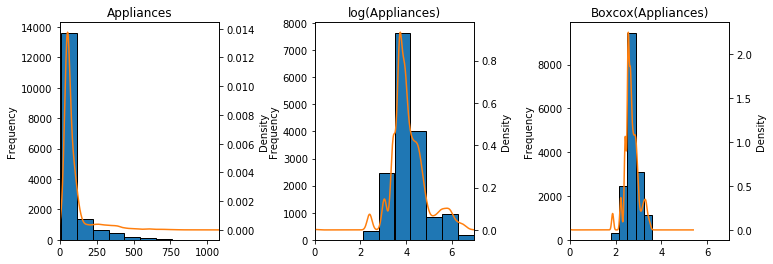

lights -1.3785448161467846


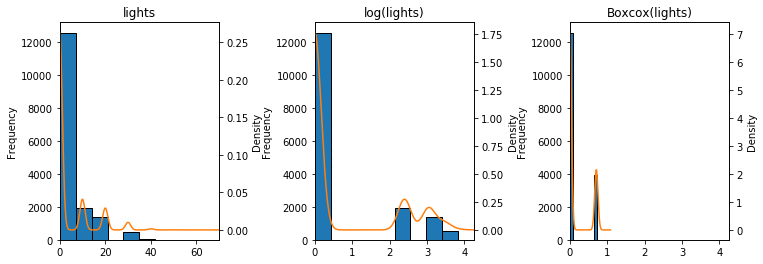

T1 0.9828093066561051


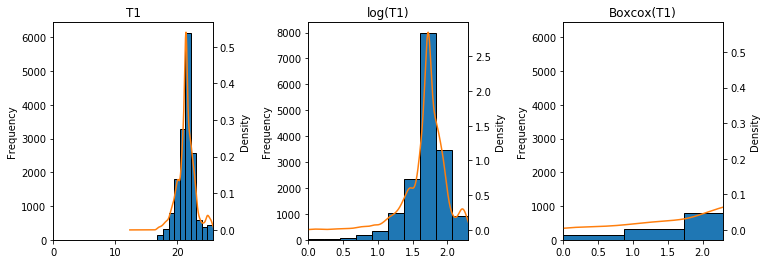

RH_1 0.5739294346798417


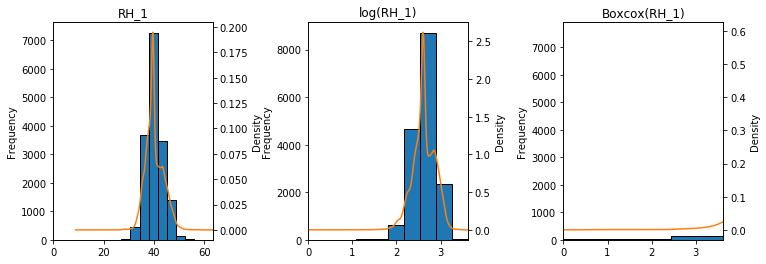

T2 0.26899198096290816


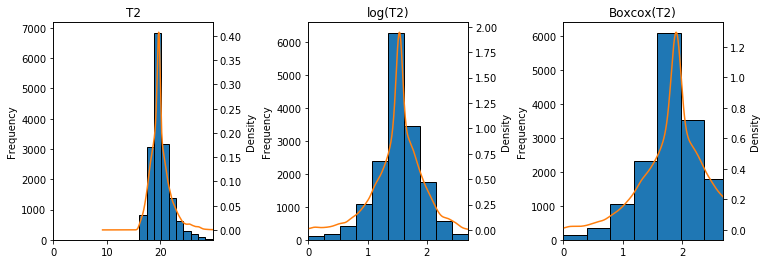

RH_2 1.7614379137109746


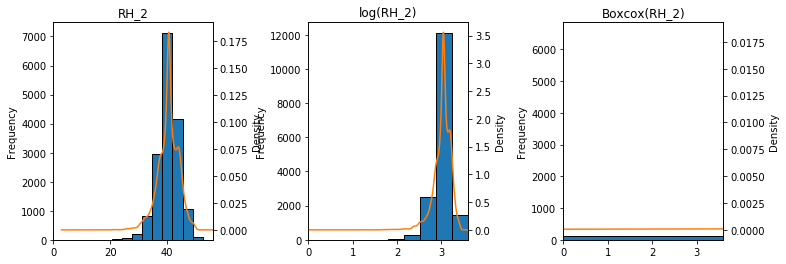

T3 0.6930087243742546


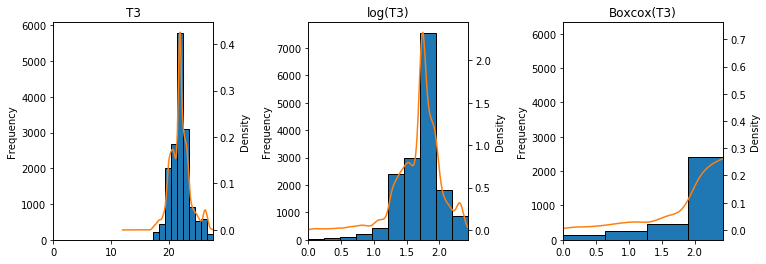

RH_3 0.20541411271708537


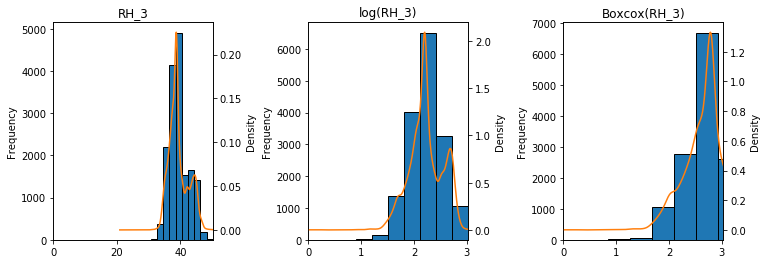

T4 0.8724643113407835


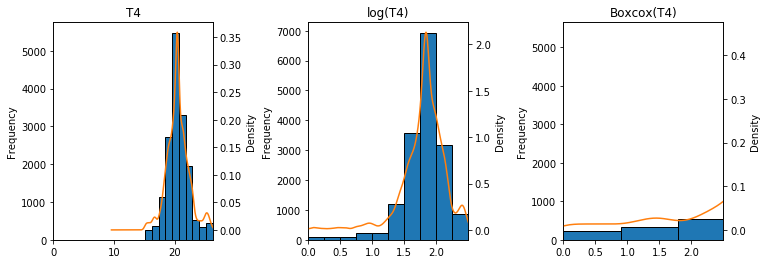

RH_4 0.3177204928258589


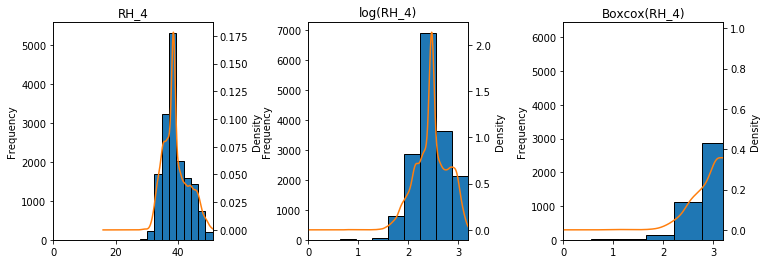

T5 0.647339470410403


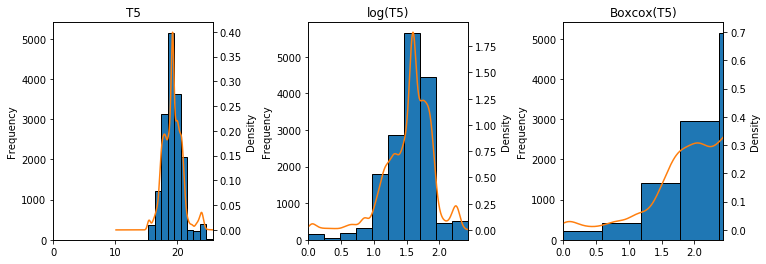

RH_5 -0.09531605699765613


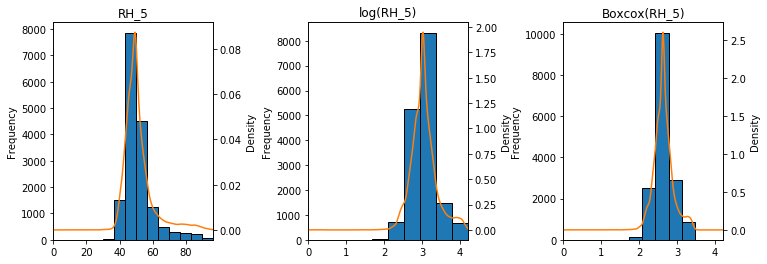

T6 0.6433966778258241


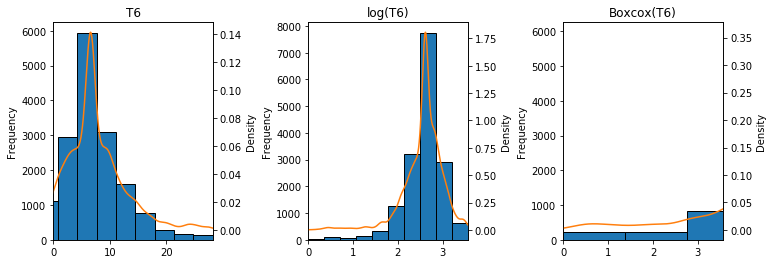

RH_6 0.9824482141280644


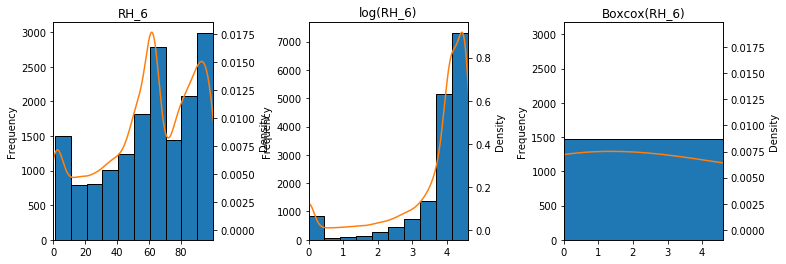

T7 0.7075052873332203


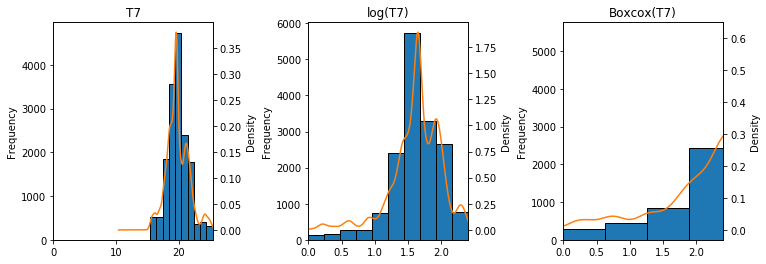

RH_7 0.604576443517989


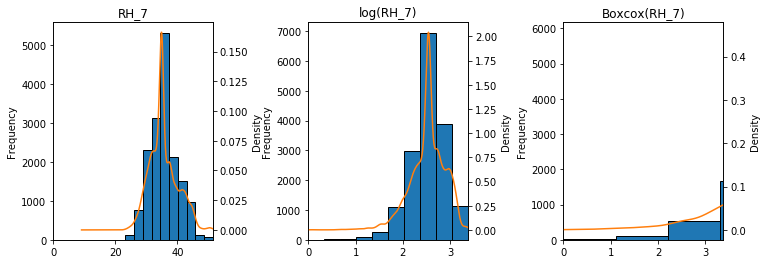

T8 1.2451127422155057


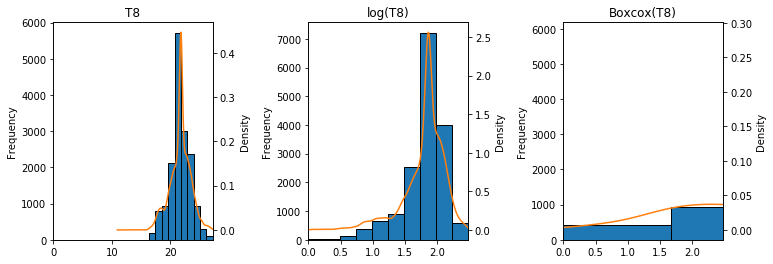

RH_8 0.5025448632123112


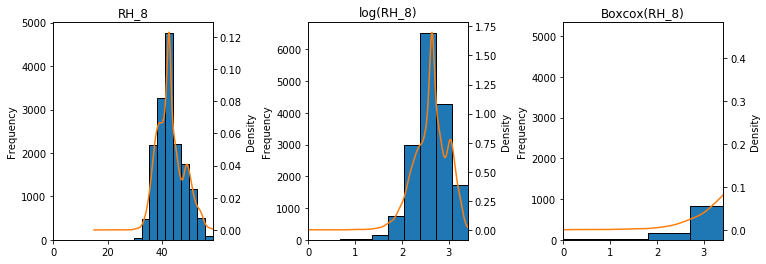

T9 0.6265203112772123


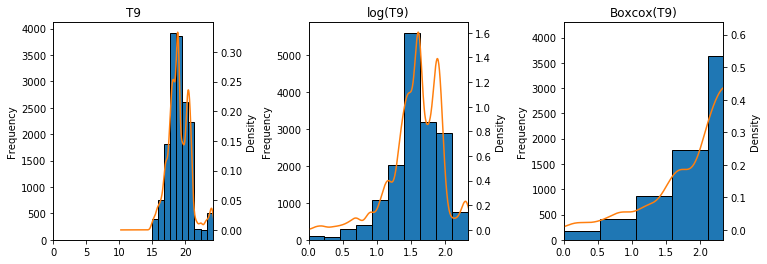

RH_9 0.5207180446505033


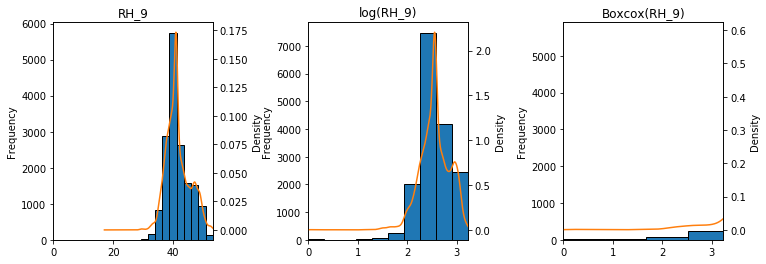

T_out 0.6317321783799436


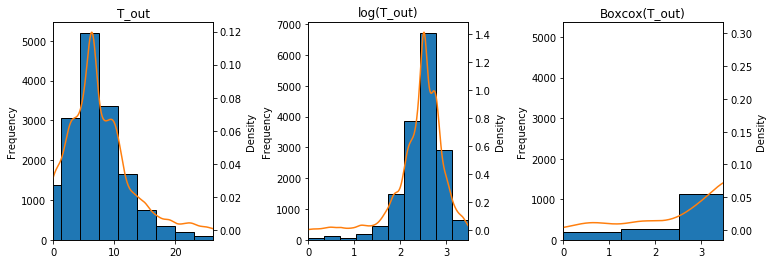

Press_mm_hg 1.3840397173005374


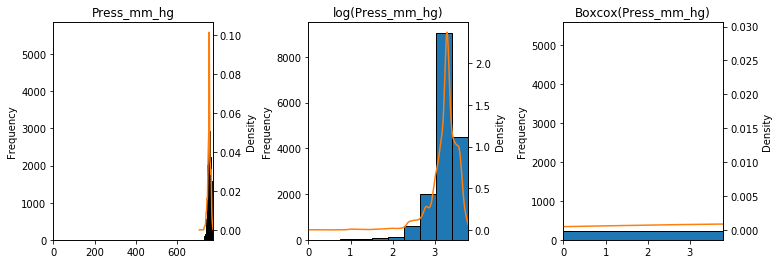

RH_out 2.3924716158795274


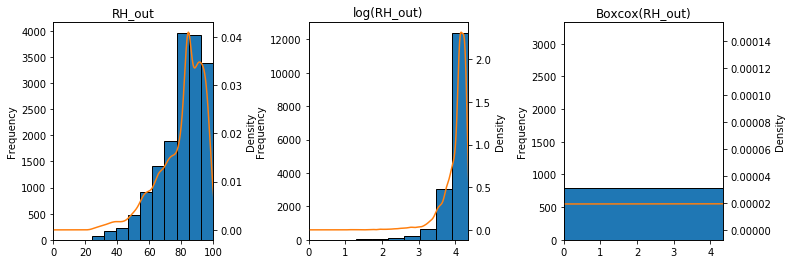

Windspeed 0.11773696164826396


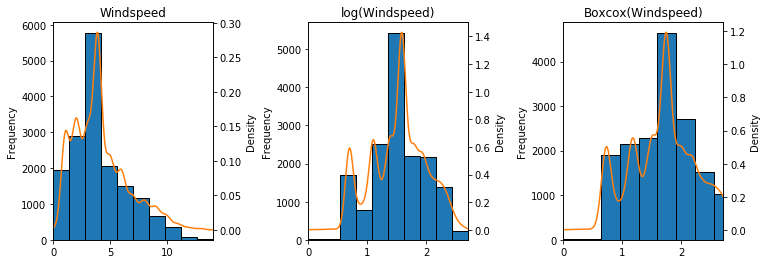

Visibility 0.7355761145278843


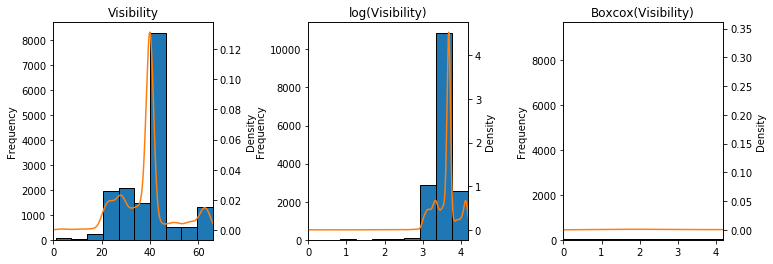

Tdewpoint 0.9139053804159235


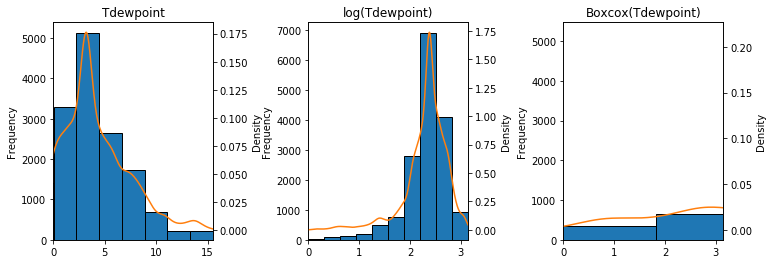

v1 0.7164238653308093


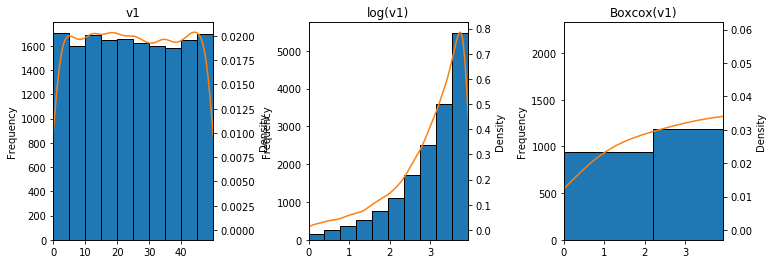

In [76]:
plot_columns = [col for col in df3.columns.tolist() if col not in ['Weekday', 'Hour']]
for col in plot_columns:
    fig = plt.figure(figsize=(12, 4))
    plt.subplots_adjust(wspace=0.6)
    
    plt.subplot(1, 3, 1)
    v = df3[col]
    ax = v.plot(kind='hist', edgecolor='black')
    ax2 = v.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(v)])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title(col)

    plt.subplot(1, 3, 2)
    v = df3[col] - df3[col].min() + 1
    ax = np.log(v).plot(kind='hist', edgecolor='black')
    ax2 = np.log(v).plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('log(' + col + ')')
    
    plt.subplot(1, 3, 3)
    l, opt_lambda = boxcox(v)
    print(col, opt_lambda)
    vt = pd.Series(boxcox(v, lmbda=opt_lambda))
    ax = vt.plot(kind='hist', edgecolor='black')
    ax2 = vt.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('Boxcox(' + col + ')')
    
    plt.show()

In [34]:
df3.reset_index(inplace=True)
df3.to_csv('df3.csv', index=False)

In [35]:
print(df3.shape)
df3.head()

(16459, 30)


,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1,Weekday,Hour
0,2016-01-11 17:00:00,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.20,48.900000,17.033333,45.53,6.600000,733.5,92.000000,7.000000,63.000000,5.3,13.275433,Mon,17
1,2016-01-11 17:10:00,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,21.79,48.863333,18.890000,45.56,6.483333,733.6,92.000000,6.666667,40.000000,5.2,18.606195,Mon,17
2,2016-01-11 17:20:00,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.20,48.730000,17.000000,45.50,6.366667,755.0,92.000000,6.333333,55.333333,5.1,28.642668,Mon,17
3,2016-01-11 17:30:00,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.10,48.590000,17.000000,45.40,6.250000,733.8,84.333333,6.000000,51.500000,5.0,45.410390,Mon,17
4,2016-01-11 17:40:00,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,34.927778,18.10,48.590000,17.000000,45.40,6.133333,733.9,84.333333,5.666667,47.666667,4.9,10.084097,Mon,17


In [51]:
excl_cols = ['date', 'Weekday', 'Hour', 'Appliances']
features = [col for col in df3.columns if col not in excl_cols]
df4 = df3[features].copy()

In [52]:
print(df4.shape)
df4.head()

(16459, 26)


,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.20,48.900000,17.033333,45.53,6.600000,733.5,92.000000,7.000000,63.000000,5.3,13.275433
1,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,21.79,48.863333,18.890000,45.56,6.483333,733.6,92.000000,6.666667,40.000000,5.2,18.606195
2,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.20,48.730000,17.000000,45.50,6.366667,755.0,92.000000,6.333333,55.333333,5.1,28.642668
3,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.10,48.590000,17.000000,45.40,6.250000,733.8,84.333333,6.000000,51.500000,5.0,45.410390
4,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,34.927778,18.10,48.590000,17.000000,45.40,6.133333,733.9,84.333333,5.666667,47.666667,4.9,10.084097


In [53]:
scaler_range = MinMaxScaler()
scaler_range.fit(df4)
df4_scaled_range = pd.DataFrame(scaler_range.transform(df4), columns=df4.columns.tolist())

print(df4_scaled_range.shape)
df4_scaled_range.head()

(16459, 26)


,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,0.428571,0.347924,0.566187,0.225345,0.682849,0.249038,0.721368,0.351351,0.764262,0.176348,0.381691,0.381039,0.841827,0.181000,0.653428,0.169103,0.661412,0.230218,0.677290,0.372990,0.097674,0.894737,0.500000,0.953846,0.538462,0.265449
1,0.428571,0.347924,0.541326,0.225345,0.680944,0.249038,0.724444,0.351351,0.782437,0.176348,0.381691,0.375396,0.839872,0.181000,0.651064,0.499438,0.660155,0.429646,0.678532,0.369239,0.100000,0.894737,0.476190,0.600000,0.533937,0.372083
2,0.428571,0.347924,0.530502,0.225345,0.678239,0.249038,0.731795,0.344745,0.778062,0.176348,0.380037,0.367420,0.830704,0.181000,0.646572,0.169103,0.655586,0.226638,0.676049,0.365488,0.597674,0.894737,0.452381,0.835897,0.529412,0.572848
3,0.571429,0.347924,0.524080,0.225345,0.677204,0.249038,0.735214,0.341441,0.770949,0.176348,0.380037,0.363723,0.833401,0.174333,0.641489,0.159902,0.650788,0.226638,0.671909,0.361736,0.104651,0.793860,0.428571,0.776923,0.524887,0.908261
4,0.571429,0.347924,0.531419,0.225345,0.675510,0.249038,0.735214,0.341441,0.762697,0.179549,0.380037,0.361777,0.848264,0.181000,0.415879,0.159902,0.650788,0.226638,0.671909,0.357985,0.106977,0.793860,0.404762,0.717949,0.520362,0.201611


lights -17.348797566307056


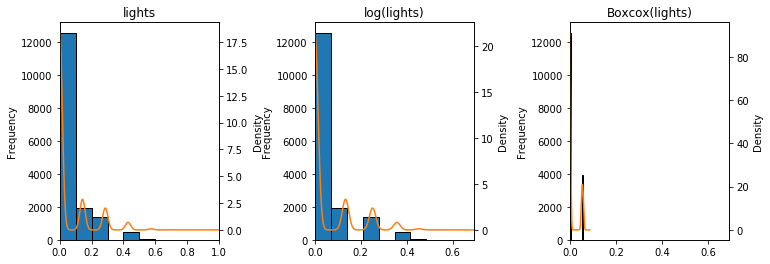

T1 0.8188768660137208


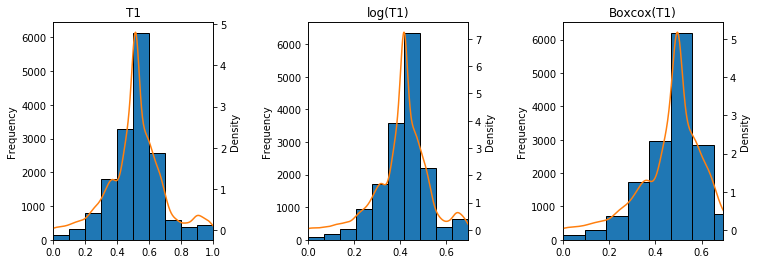

RH_1 -0.8867722582606924


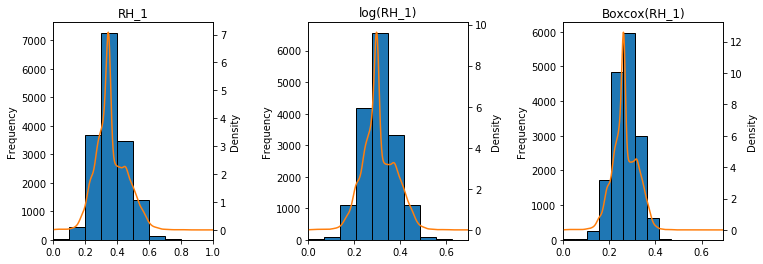

T2 -1.94506101183879


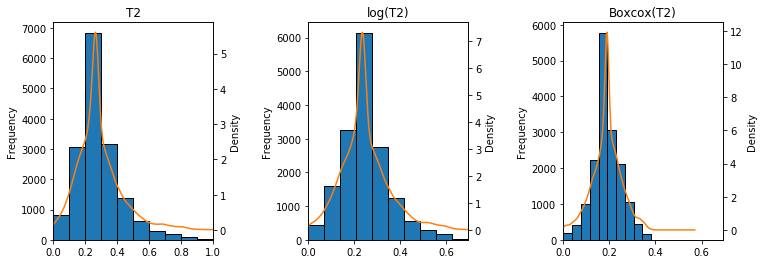

RH_2 3.1618737235866052


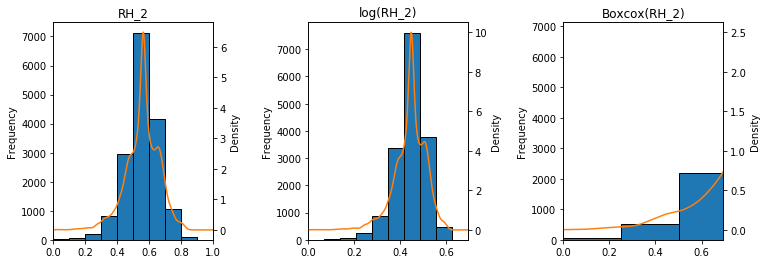

T3 -0.0126608808080881


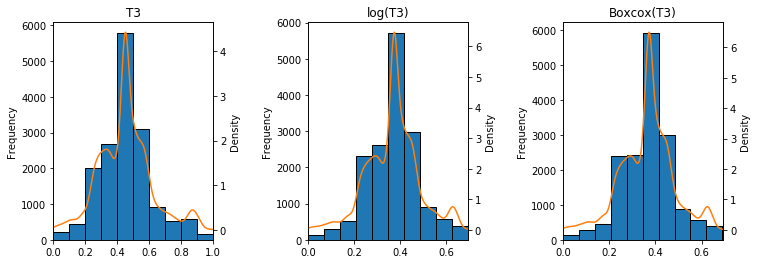

RH_3 -1.4632725608765254


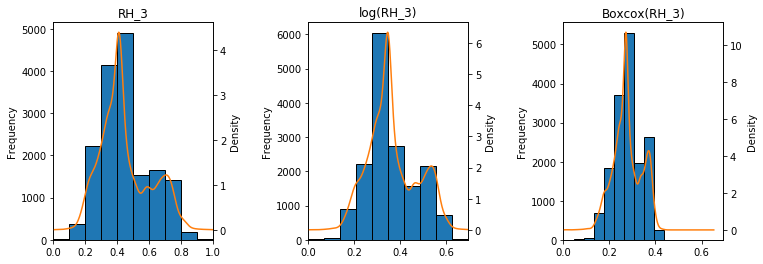

T4 0.48097906030796317


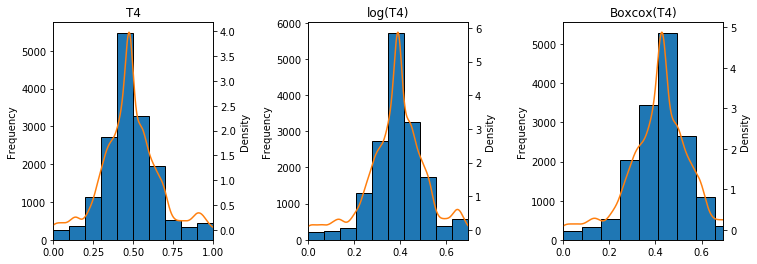

RH_4 -1.0333026486881611


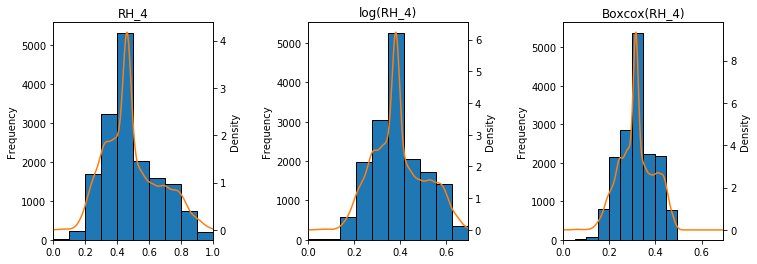

T5 -0.2576663416576344


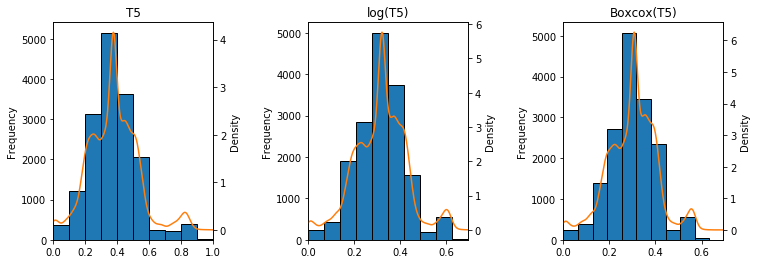

RH_5 -4.434123072930612


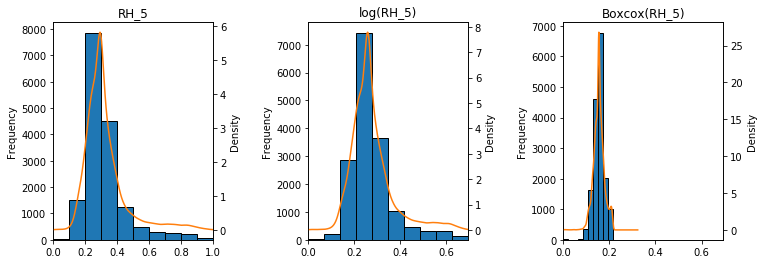

T6 -0.5965976584232575


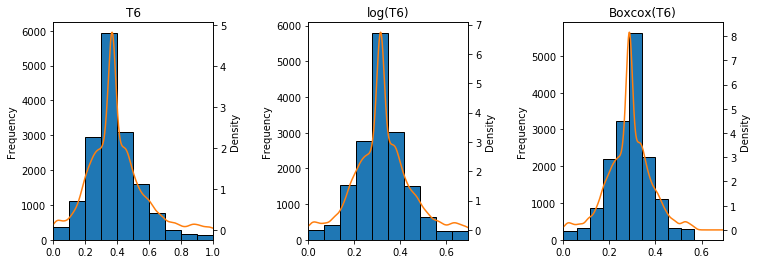

RH_6 2.1830602757326822


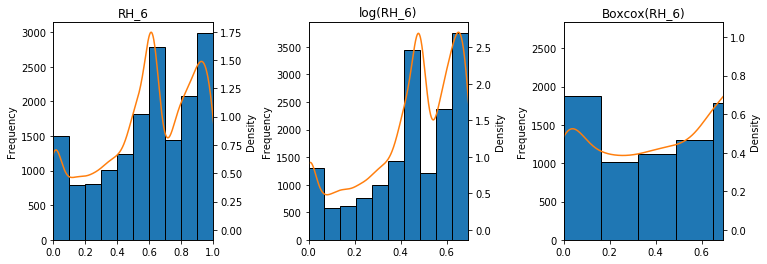

T7 0.04714519679401336


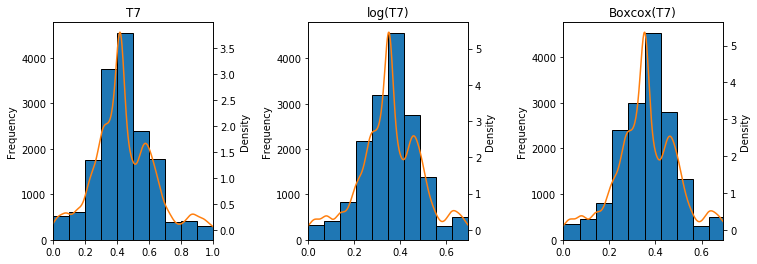

RH_7 -0.38503107169498


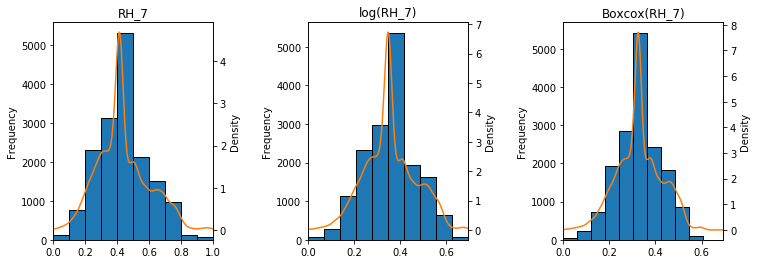

T8 1.6832756413891634


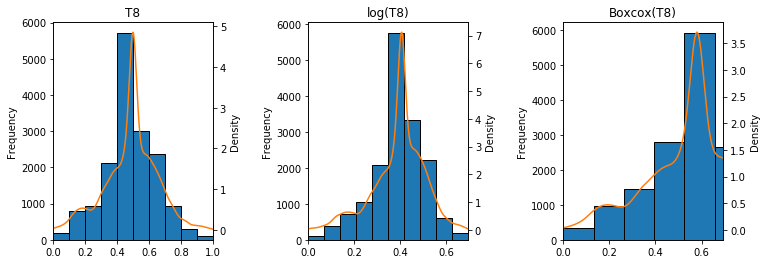

RH_8 -0.6038886957768921


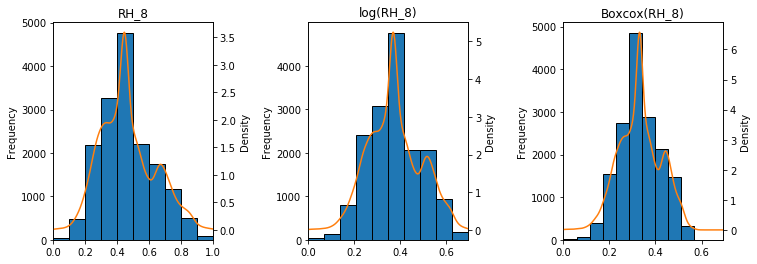

T9 -0.1333838694686498


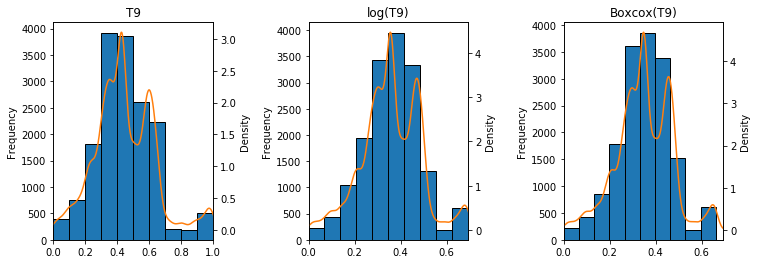

RH_9 -0.6202780707870804


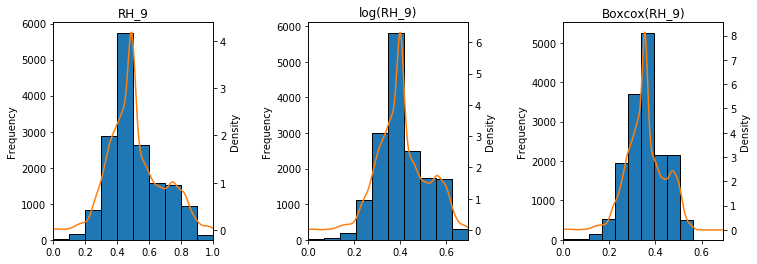

T_out -0.5567681792544024


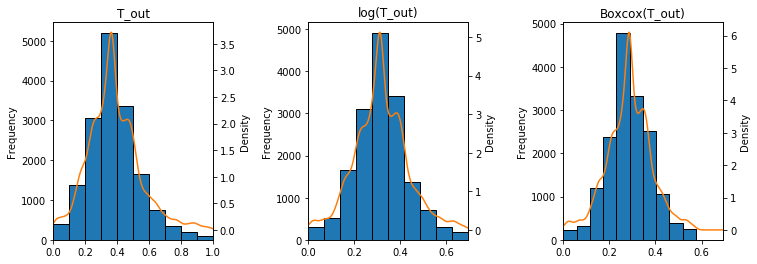

Press_mm_hg 2.19277267788724


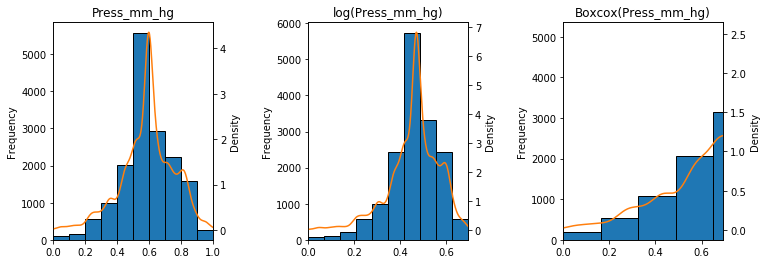

RH_out 5.238040267980651


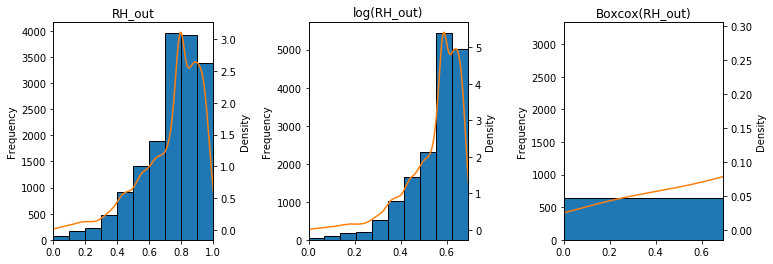

Windspeed -2.0125324759115037


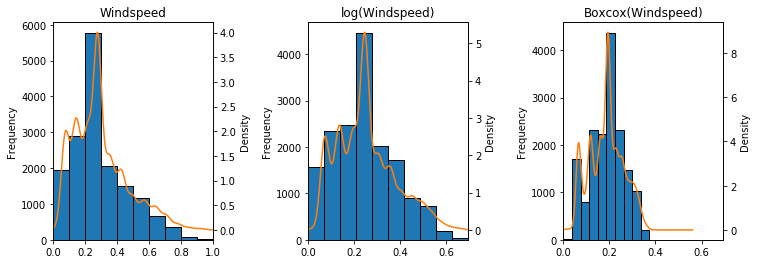

Visibility -0.03344366980011182


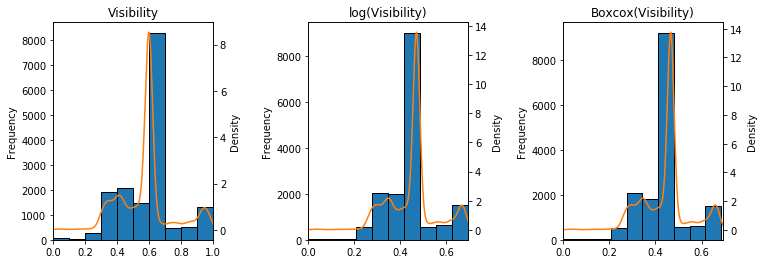

Tdewpoint 0.651574342660373


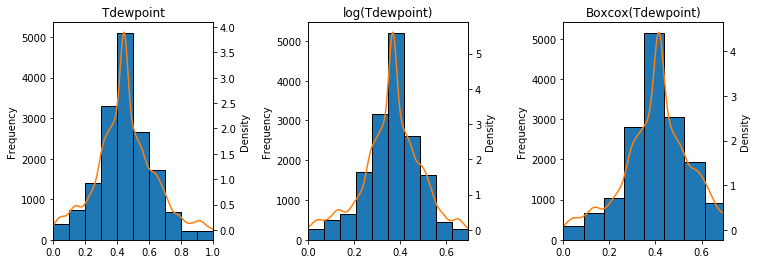

v1 0.7129119459116151


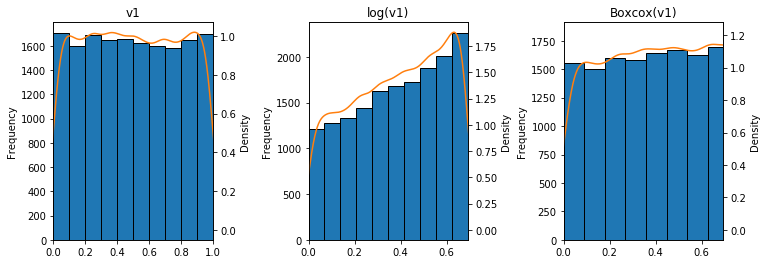

In [46]:
df = df4_scaled_range.copy()
for col in df.columns:
    fig = plt.figure(figsize=(12, 4))
    plt.subplots_adjust(wspace=0.6)
    
    plt.subplot(1, 3, 1)
    v = df[col]
    ax = v.plot(kind='hist', edgecolor='black')
    ax2 = v.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(v)])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title(col)

    plt.subplot(1, 3, 2)
    v = df[col] + 1
    ax = np.log(v).plot(kind='hist', edgecolor='black')
    ax2 = np.log(v).plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('log(' + col + ')')
    
    plt.subplot(1, 3, 3)
    l, opt_lambda = boxcox(v)
    print(col, opt_lambda)
    vt = pd.Series(boxcox(v, lmbda=opt_lambda))
    ax = vt.plot(kind='hist', edgecolor='black')
    ax2 = vt.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('Boxcox(' + col + ')')
    
    plt.show()

In [56]:
df3_scaled_range = pd.concat([df3[['date', 'Appliances', 'Weekday', 'Hour']], df4_scaled_range], axis=1)
print(df3_scaled_range.shape)
df3_scaled_range.head()

(16459, 30)


,date,Appliances,Weekday,Hour,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,2016-01-11 17:00:00,60.0,Mon,17,0.428571,0.347924,0.566187,0.225345,0.682849,0.249038,0.721368,0.351351,0.764262,0.176348,0.381691,0.381039,0.841827,0.181000,0.653428,0.169103,0.661412,0.230218,0.677290,0.372990,0.097674,0.894737,0.500000,0.953846,0.538462,0.265449
1,2016-01-11 17:10:00,60.0,Mon,17,0.428571,0.347924,0.541326,0.225345,0.680944,0.249038,0.724444,0.351351,0.782437,0.176348,0.381691,0.375396,0.839872,0.181000,0.651064,0.499438,0.660155,0.429646,0.678532,0.369239,0.100000,0.894737,0.476190,0.600000,0.533937,0.372083
2,2016-01-11 17:20:00,50.0,Mon,17,0.428571,0.347924,0.530502,0.225345,0.678239,0.249038,0.731795,0.344745,0.778062,0.176348,0.380037,0.367420,0.830704,0.181000,0.646572,0.169103,0.655586,0.226638,0.676049,0.365488,0.597674,0.894737,0.452381,0.835897,0.529412,0.572848
3,2016-01-11 17:30:00,50.0,Mon,17,0.571429,0.347924,0.524080,0.225345,0.677204,0.249038,0.735214,0.341441,0.770949,0.176348,0.380037,0.363723,0.833401,0.174333,0.641489,0.159902,0.650788,0.226638,0.671909,0.361736,0.104651,0.793860,0.428571,0.776923,0.524887,0.908261
4,2016-01-11 17:40:00,60.0,Mon,17,0.571429,0.347924,0.531419,0.225345,0.675510,0.249038,0.735214,0.341441,0.762697,0.179549,0.380037,0.361777,0.848264,0.181000,0.415879,0.159902,0.650788,0.226638,0.671909,0.357985,0.106977,0.793860,0.404762,0.717949,0.520362,0.201611


In [58]:
df3_scaled_range.to_csv('df3_scaled_range.csv', index=False)

In [48]:
scaler_std = StandardScaler()
scaler_std.fit(df4)
df4_scaled_std = pd.DataFrame(scaler_std.transform(df4), columns=df4.columns.tolist())

print(df4_scaled_std.shape)
df4_scaled_std.head()

(16459, 26)


,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,3.231241,-1.09499,2.113623,-0.445822,1.194013,-1.285808,1.762145,-0.812217,1.629336,-1.369659,0.463030,-0.026434,0.850218,-1.469526,1.384072,-2.033595,1.187422,-1.192070,1.027631,-0.050704,-3.069583,0.799435,1.221286,2.301398,0.533613,-0.803163
1,3.231241,-1.09499,1.856544,-0.445822,1.175484,-1.285808,1.781891,-0.812217,1.736554,-1.369659,0.463030,-0.062940,0.843546,-1.469526,1.369115,0.056796,1.179870,-0.083576,1.035410,-0.074506,-3.055168,0.799435,1.079926,0.130482,0.506444,-0.435948
2,3.231241,-1.09499,1.744605,-0.445822,1.149178,-1.285808,1.829060,-0.852779,1.710747,-1.369659,0.450378,-0.114551,0.812258,-1.469526,1.340698,-2.033595,1.152408,-1.211971,1.019852,-0.098308,0.029658,0.799435,0.938567,1.577760,0.479274,0.255426
3,4.471892,-1.09499,1.678200,-0.445822,1.139113,-1.285808,1.850999,-0.873061,1.668783,-1.369659,0.450378,-0.138468,0.821460,-1.507388,1.308541,-2.091823,1.123572,-1.211971,0.993923,-0.122110,-3.026338,0.256100,0.797207,1.215940,0.452105,1.410489
4,4.471892,-1.09499,1.754091,-0.445822,1.122643,-1.285808,1.850999,-0.873061,1.620104,-1.348127,0.450378,-0.151057,0.872188,-1.469526,-0.118812,-2.091823,1.123572,-1.211971,0.993923,-0.145911,-3.011923,0.256100,0.655848,0.854121,0.424936,-1.023002


lights -3.4928253044341586


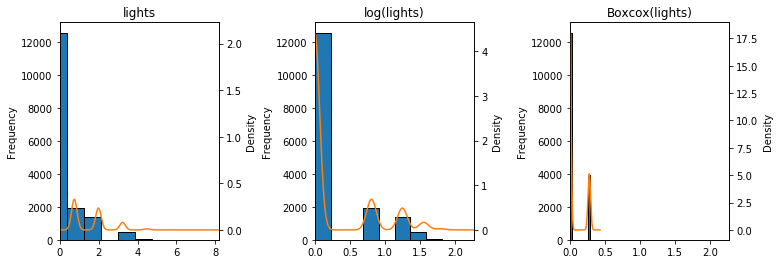

T1 0.9751820007579659


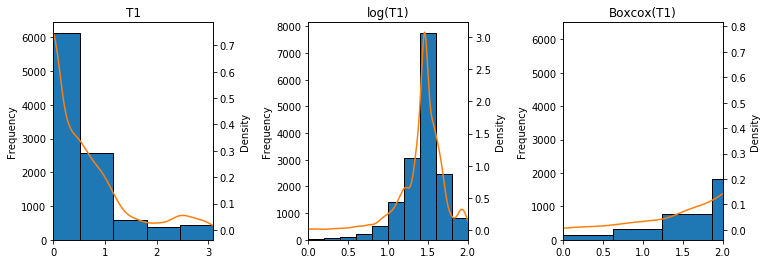

RH_1 0.44984886534178575


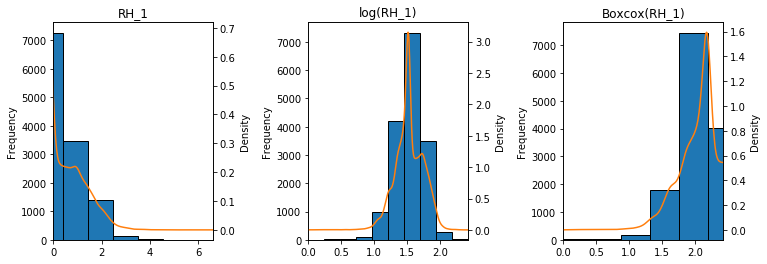

T2 0.09642391800223277


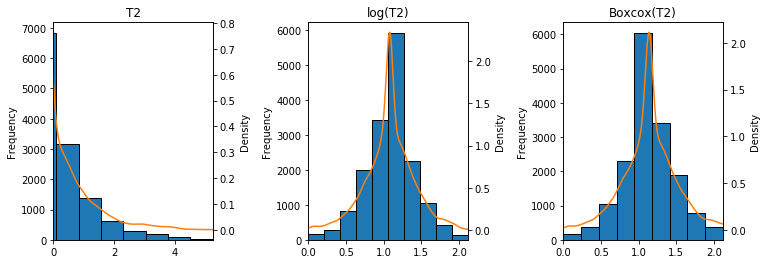

RH_2 1.8794494478806736


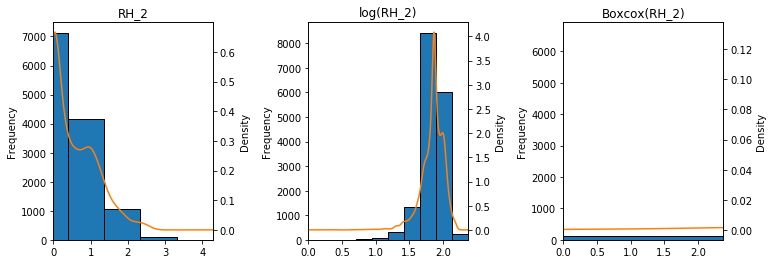

T3 0.6381283164297793


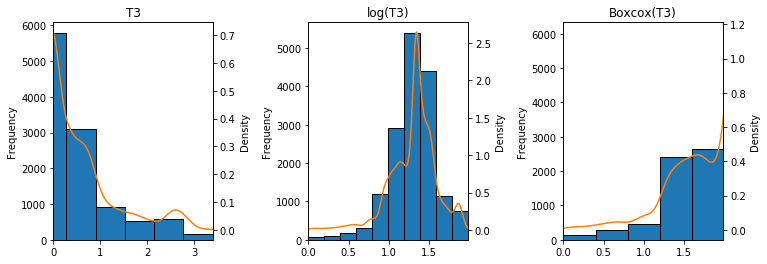

RH_3 -0.0022895407050019124


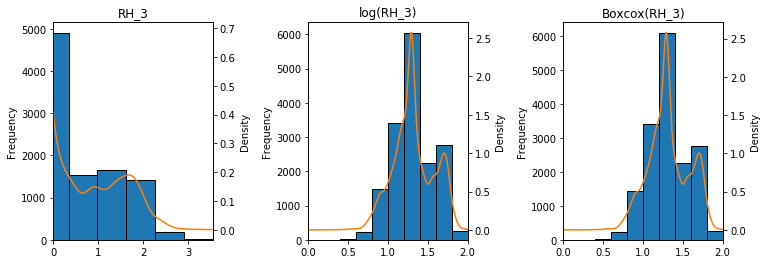

T4 0.8395476745762549


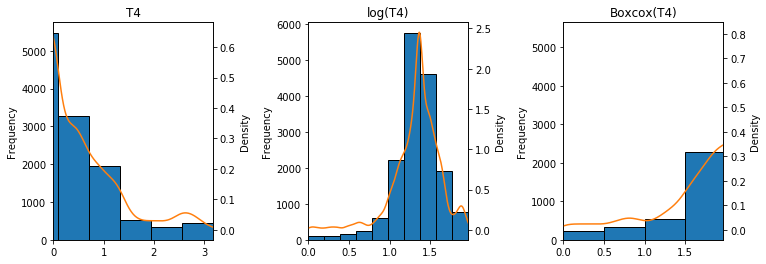

RH_4 0.11813592678304435


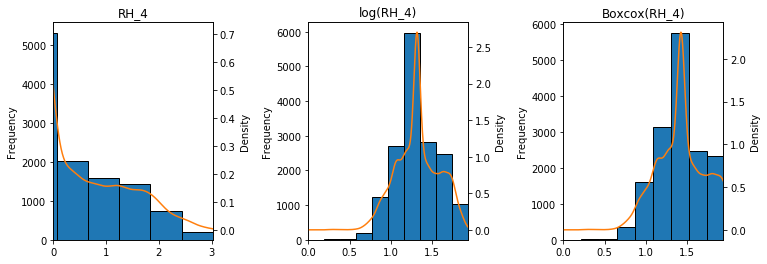

T5 0.5886157324955233


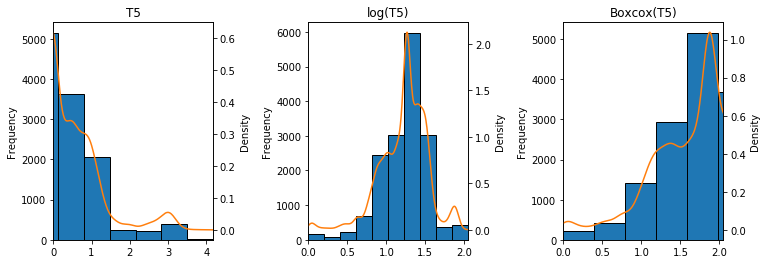

RH_5 -0.7651577683085041


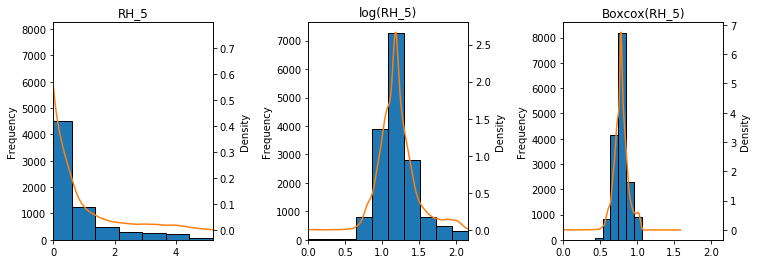

T6 0.4596854343116858


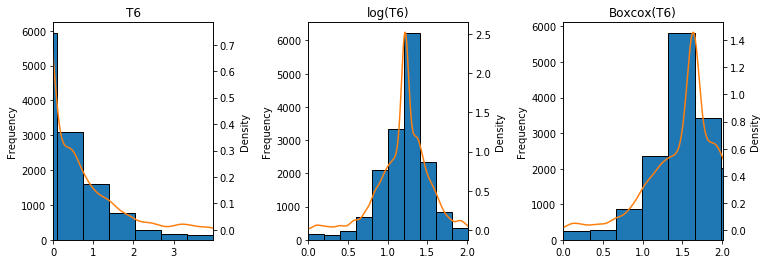

RH_6 1.4636680081399105


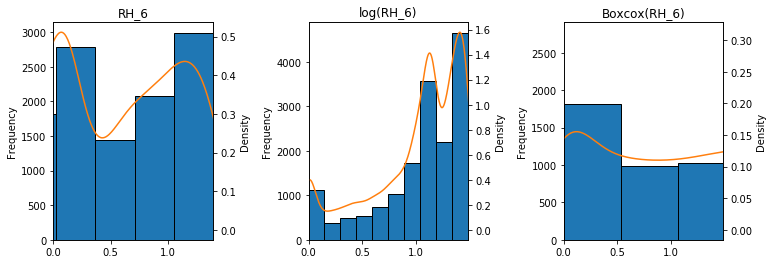

T7 0.6472233739974482


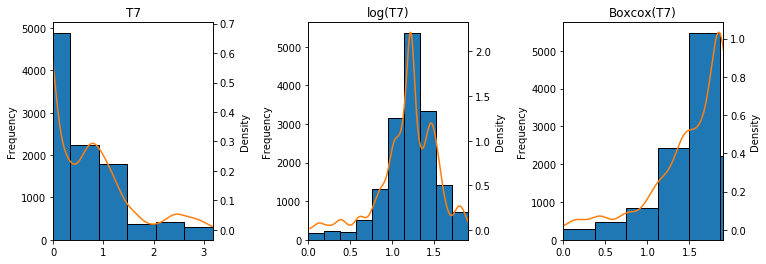

RH_7 0.4631095530959519


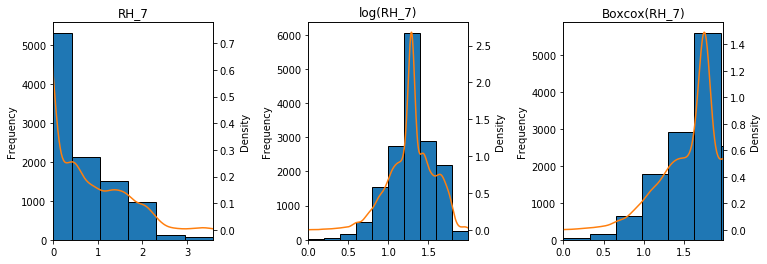

T8 1.2833443932411055


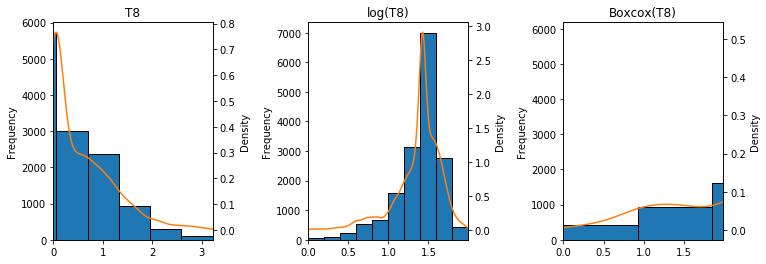

RH_8 0.32916938150760805


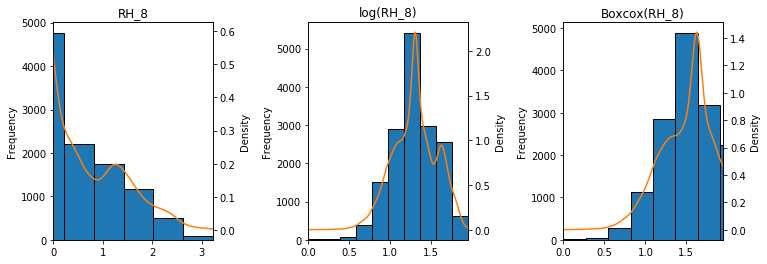

T9 0.5594209216450585


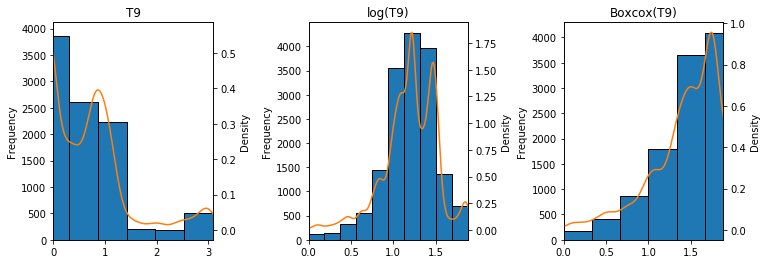

RH_9 0.3533120487216356


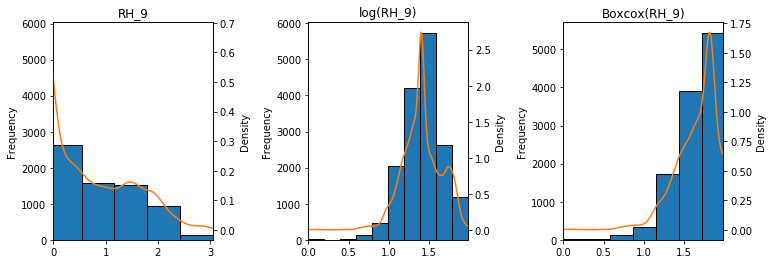

T_out 0.45530505530479387


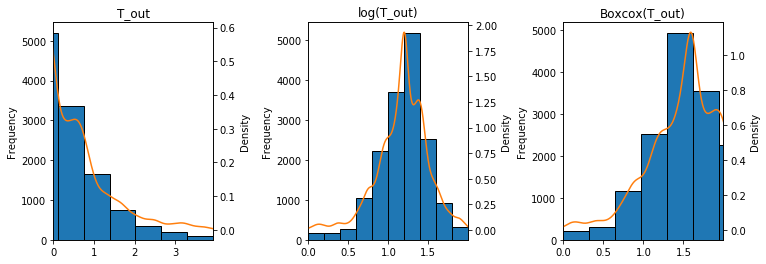

Press_mm_hg 1.5187526016512918


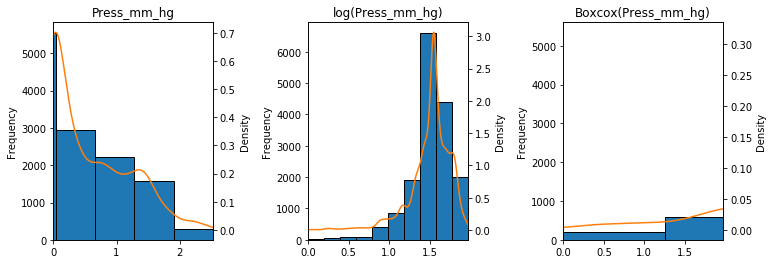

RH_out 2.9502272609476115


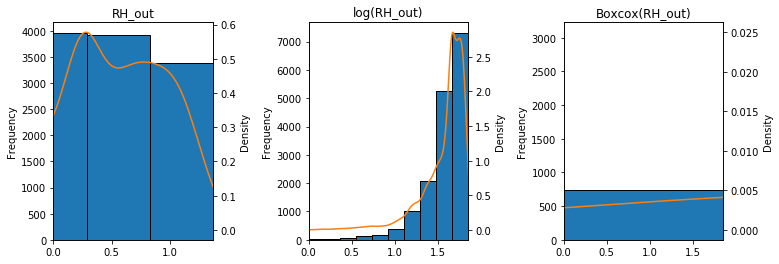

Windspeed -0.12443130101433442


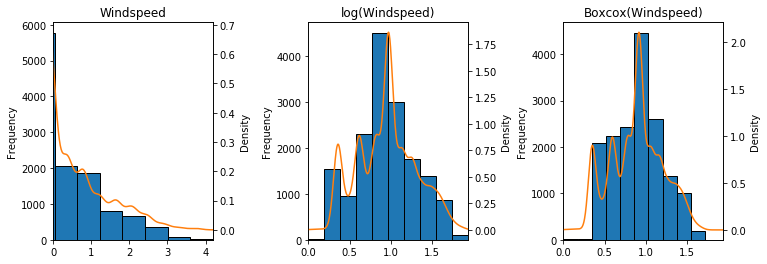

Visibility 0.59998885044306


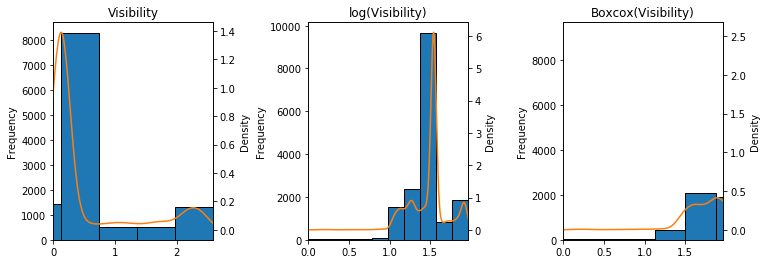

Tdewpoint 0.882994195208242


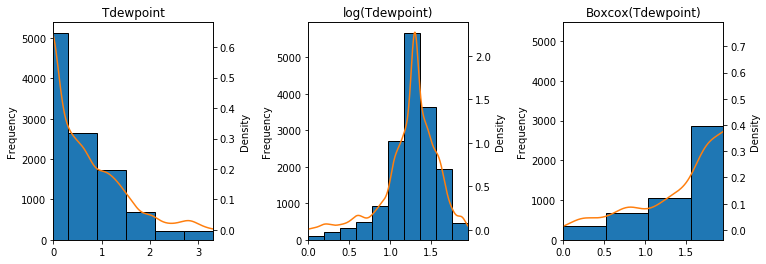

v1 0.7272630500640584


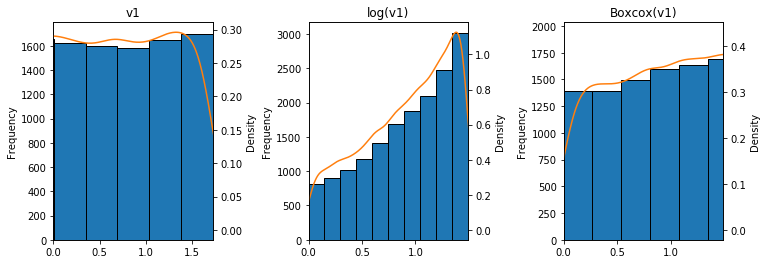

In [49]:
df = df4_scaled_std.copy()
for col in df.columns:
    fig = plt.figure(figsize=(12, 4))
    plt.subplots_adjust(wspace=0.6)
    
    plt.subplot(1, 3, 1)
    v = df[col]
    ax = v.plot(kind='hist', edgecolor='black')
    ax2 = v.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(v)])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title(col)

    plt.subplot(1, 3, 2)
    v = df[col] - df[col].min() + 1
    ax = np.log(v).plot(kind='hist', edgecolor='black')
    ax2 = np.log(v).plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('log(' + col + ')')
    
    plt.subplot(1, 3, 3)
    l, opt_lambda = boxcox(v)
    print(col, opt_lambda)
    vt = pd.Series(boxcox(v, lmbda=opt_lambda))
    ax = vt.plot(kind='hist', edgecolor='black')
    ax2 = vt.plot(kind='kde', ax=ax, secondary_y=True, xlim=[0, max(np.log(v))])
    ax.set_ylabel('Frequency')
    ax2.set_ylabel('Density')
    ax.set_title('Boxcox(' + col + ')')
    
    plt.show()

In [57]:
df3_scaled_std = pd.concat([df3[['date', 'Appliances', 'Weekday', 'Hour']], df4_scaled_std], axis=1)
print(df3_scaled_std.shape)
df3_scaled_std.head()

(16459, 30)


,date,Appliances,Weekday,Hour,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,v1
0,2016-01-11 17:00:00,60.0,Mon,17,3.231241,-1.09499,2.113623,-0.445822,1.194013,-1.285808,1.762145,-0.812217,1.629336,-1.369659,0.463030,-0.026434,0.850218,-1.469526,1.384072,-2.033595,1.187422,-1.192070,1.027631,-0.050704,-3.069583,0.799435,1.221286,2.301398,0.533613,-0.803163
1,2016-01-11 17:10:00,60.0,Mon,17,3.231241,-1.09499,1.856544,-0.445822,1.175484,-1.285808,1.781891,-0.812217,1.736554,-1.369659,0.463030,-0.062940,0.843546,-1.469526,1.369115,0.056796,1.179870,-0.083576,1.035410,-0.074506,-3.055168,0.799435,1.079926,0.130482,0.506444,-0.435948
2,2016-01-11 17:20:00,50.0,Mon,17,3.231241,-1.09499,1.744605,-0.445822,1.149178,-1.285808,1.829060,-0.852779,1.710747,-1.369659,0.450378,-0.114551,0.812258,-1.469526,1.340698,-2.033595,1.152408,-1.211971,1.019852,-0.098308,0.029658,0.799435,0.938567,1.577760,0.479274,0.255426
3,2016-01-11 17:30:00,50.0,Mon,17,4.471892,-1.09499,1.678200,-0.445822,1.139113,-1.285808,1.850999,-0.873061,1.668783,-1.369659,0.450378,-0.138468,0.821460,-1.507388,1.308541,-2.091823,1.123572,-1.211971,0.993923,-0.122110,-3.026338,0.256100,0.797207,1.215940,0.452105,1.410489
4,2016-01-11 17:40:00,60.0,Mon,17,4.471892,-1.09499,1.754091,-0.445822,1.122643,-1.285808,1.850999,-0.873061,1.620104,-1.348127,0.450378,-0.151057,0.872188,-1.469526,-0.118812,-2.091823,1.123572,-1.211971,0.993923,-0.145911,-3.011923,0.256100,0.655848,0.854121,0.424936,-1.023002


In [59]:
df3_scaled_std.to_csv('df3_scaled_std.csv', index=False)